In [60]:
import numpy as np
import matplotlib.pyplot as plt
import math
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 100

### Luiz Felipe Diniz Costa - 13782032

## Questão 1 (Medida e Vetores):

Faça a conversão de unidades conforme solicitado nos itens abaixo, sempre usando 4 casas decimais, se necessário:

a) $\frac{cm}{h}$ $\Rightarrow$ $\frac{m}{s}$

b) libra $\Rightarrow$ onça (oz) $\Rightarrow$ quilograma (Kg)

c) erg/s (CSG) para Watts (SI)

d) parsec $\Rightarrow$ m sabendo que 1 parsec vale aproximadamente 3,26 anos-luz. Calcule o valor do ano luz em m partindo da velocidade da luz (c) e converta parsec (pc) para metro.


### RESOLUÇÃO:


In [61]:
# a)
def item_a():
    """aqui convertemos 1 centimetro por hora (cm/h) para metros por segundo (m/s)"""
    
    # 1 cm = 1e-2 m
    # h -> s: 1h = 3600s
    
    CM_TO_M = 1e-2
    H_TO_S = 3600.0
    
    cm_per_h = 1.0
    
    # regra de três direta: (cm/h) * (m/cm) / (s/h) = m/s
    resultado_a = cm_per_h * CM_TO_M / H_TO_S
    
    # nota: usei notação científica pois o resultado é muito pequeno
    return "{:.4e}".format(resultado_a)

a = item_a()
print(f"Um cm/h é equivalente a {a} m/s")

Um cm/h é equivalente a 2.7778e-06 m/s


In [62]:
# b)
def item_b():
    """aqui convertemos 1 libra para onças e depois para quilogramas (kg)"""

    # 1 libra = 16 onças
    # 1 onça = 0.0283495 kg

    LB_TO_OZ = 16.0
    OZ_TO_KG = 0.0283495

    lb = 1.0

    # conversão: (lb * oz/lb) * (kg/oz) = kg
    resultado_b = lb * LB_TO_OZ * OZ_TO_KG

    return "{:.4f}".format(resultado_b)

b = item_b()
print(f"Uma libra equivale a {b} Kg")


Uma libra equivale a 0.4536 Kg


In [63]:
# c)
def item_c():
    """aqui convertemos 1 erg por segundo (erg/s) do sistema CGS para Watt (W) do sistema SI"""
    # 1 erg = 1e-7 joules
    # 1 W = 1 J/s, portanto: 1 erg/s = 1e-7 W

    ERG_TO_J = 1e-7

    erg_per_s = 1.0

    # conversão direta: (erg/s) * (J/erg) = W
    resultado_c = erg_per_s * ERG_TO_J

    return "{:.4e}".format(resultado_c)

c = item_c()
print(f"Um erg/s equivale a {c} W")


Um erg/s equivale a 1.0000e-07 W


In [65]:
# d)
def item_d():
    """aqui convertemos 1 parsec (pc) para metros (m), sabendo que 1 pc ≈ 3,26 anos-luz"""

    # velocidade da luz no vácuo em m/s
    C = 299_792_458.0

    # número de segundos em um ano: 365.25 dias × 24 h/dia × 3600 s/h
    YEAR_IN_SECONDS = 365.25 * 24.0 * 3600.0

    # 1 ano-luz em metros = c * tempo de 1 ano
    LIGHT_YEAR_M = C * YEAR_IN_SECONDS

    # 1 parsec = 3.26 anos-luz
    PARSEC_TO_LY = 3.26

    # conversão final: pc -> ly -> m
    resultado_d = PARSEC_TO_LY * LIGHT_YEAR_M

    return "{:.4e}".format(resultado_d)

d = item_d()
print(f"Um parsec equivale a {d} m")


Um parsec equivale a 3.0842e+16 m


## Questão 2 (Medida e Vetores):


Um avião sai de Brasília com direção á Belo Horizonte com uma velocidade $\vec{V_0} = 55$ nós por 452 Km através da geodésica, esse deslocamento acontece em um ângulo de -46,4° em relação à linha do equador. Em seguida viaja a uma velocidade constante entre Belo Horizonte e Salvador, percorrendo 1200 Km em 1h 45min em linha reta, formando um ângulo de 53,13° entre o vetor deslocamento e a linha do equador. Esse mesmo avião volta de Salvador para Brasília em um total de 1h 55min. A partir das informações acima calcule:

a) O vetor velocidade do avião no trajeto Belo Horizonte $⇒$ Salvador.

b) A distância em linha reta entre Salvador e Brasília.

c) Defina a posição cartesiana de cada uma das cidades.

d) O vetor de deslocamento total realizado no trajeto.

e) O vetor velocidade do avião no trajeto Salvador $⇒$ Brasília.

f) O vetor de velocidade média total da viagem.

g) A rapidez média do trajeto.

Considere todos os movimentos retilíneos em um plano cartesiano e Brasília localizado na origem (0,0).


###


In [66]:
"""
 NÃO ALTERE ESSA CÉLULA
"""

def Plot_vetor_velocidade(ax, comprimento_x, comprimento_y, rotulo, origin=(0,0), color='blue'):
    x0, y0 = origin
    dx, dy = comprimento_x, comprimento_y

    ax.scatter(x0, y0, color=color, s=30, zorder=5)

    ax.quiver(x0, y0, dx, 0, angles='xy', scale_units='xy',
              color=color, width=.003, alpha=.6, scale=2)
    ax.text(x0 + dx/2, y0 - 0.3, "v_x", color='black')

    ax.quiver(x0, y0, 0, dy, angles='xy', scale_units='xy',
              color=color, width=.003, alpha=.6, scale=2)

    ax.text(x0 - 0.3, y0 + dy/2, "v_y", color='black')

    ax.quiver(x0, y0, dx, dy, angles='xy', scale_units='xy',
              color=color, width=.005, label=rotulo, scale=2)

    return ax


def Plot_vetor_deslocamento(ax, comprimento_x, comprimento_y, rotulo, origin=(0,0), color='black'):
    x0, y0 = origin
    dx, dy = comprimento_x, comprimento_y

    ax.quiver(x0, y0, dx, dy, angles='xy', scale_units='xy',
              color=color, width=.004, label=rotulo, scale=1)

    return ax

### RESOLUÇÃO:


In [67]:
# a)
def Calculo_velocidade_BH_SALVADOR():
    """
    calcula a velocidade do avião de belo horizonte para salvador e retorna as componentes x e y do vetor velocidade
    unidades:
      distância: km
      tempo: h
      velocidade: km/h
      ângulo: graus em relação à linha do equador (eixo x)
    """
    # dados do enunciado
    DIST_KM = 1200.0           # distância entre bh e salvador em km
    TIME_H = 1.0 + 45.0/60.0   # 1 h 45 min = 1.75 h
    THETA_DEG = 53.13          # ângulo do vetor deslocamento em relação ao equador

    # velocidade escalar média: v = d / t
    v_mag_kmh = DIST_KM / TIME_H

    # conversão de ângulo para radianos
    theta_rad = math.radians(THETA_DEG)

    # componentes da velocidade
    velocidade_BH_SALVADOR_x = v_mag_kmh * math.cos(theta_rad)
    velocidade_BH_SALVADOR_y = v_mag_kmh * math.sin(theta_rad)

    return velocidade_BH_SALVADOR_x, velocidade_BH_SALVADOR_y

vx, vy = Calculo_velocidade_BH_SALVADOR()
print(f"Componentes da velocidade (km/h): v_x = {vx:.4f}, v_y = {vy:.4f}")


Componentes da velocidade (km/h): v_x = 411.4296, v_y = 548.5707


In [68]:
# b)

def Distancia_SALVADOR_BRASILIA():
    """
    calcula a distância em linha reta entre salvador e brasília a partir da soma vetorial:
    brasília -> belo horizonte (geodésica) e belo horizonte -> salvador (retilíneo)
    unidades: km
    ângulos em graus, medidos em relação à linha do equador (eixo x)
    """
    # dados do trecho brasília -> belo horizonte
    D1_KM = 452.0
    THETA1_DEG = -46.4

    # dados do trecho belo horizonte -> salvador
    D2_KM = 1200.0
    THETA2_DEG = 53.13

    # converte ângulos para radianos
    theta1 = math.radians(THETA1_DEG)
    theta2 = math.radians(THETA2_DEG)

    # componentes dos deslocamentos
    d1x = D1_KM * math.cos(theta1)
    d1y = D1_KM * math.sin(theta1)

    d2x = D2_KM * math.cos(theta2)
    d2y = D2_KM * math.sin(theta2)

    # soma vetorial para obter brasília -> salvador
    dx = d1x + d2x
    dy = d1y + d2y

    # módulo do vetor resultante é a distância em linha reta
    distancia_SALVADOR_BRASILIA = math.sqrt(dx*dx + dy*dy)

    return distancia_SALVADOR_BRASILIA

dist = Distancia_SALVADOR_BRASILIA()
print(f"Distância em linha reta (Salvador <-> Brasília): {dist:.4f} km")


Distância em linha reta (Salvador <-> Brasília): 1210.2480 km


In [69]:
# c)

def Posicao_BRASILIA():
    """
    calcula a posição cartesiana de brasília
    convenção: brasília na origem do sistema (0, 0)
    unidades: km
    eixo x alinhado à linha do equador; ângulos medidos a partir do eixo x
    """
    # origem por convenção
    posicao_x, posicao_y = 0.0, 0.0
    return posicao_x, posicao_y


def Posicao_BELO_HORIZONTE():
    """
    calcula a posição cartesiana de belo horizonte a partir do deslocamento brasília -> belo horizonte
    dados: 452 km a -46.4° em relação ao equador (eixo x)
    """
    # constantes do trecho brasília -> belo horizonte
    D_BRAS_BH_KM = 452.0
    THETA_BRAS_BH_DEG = -46.4

    # converte ângulo para radianos
    theta = math.radians(THETA_BRAS_BH_DEG)

    # componentes do deslocamento
    dx = D_BRAS_BH_KM * math.cos(theta)
    dy = D_BRAS_BH_KM * math.sin(theta)

    # posição de bh, tomando brasília na origem
    posicao_x, posicao_y = dx, dy
    return posicao_x, posicao_y


def Posicao_SALVADOR():
    """
    calcula a posição cartesiana de salvador usando a soma vetorial:
    brasília -> belo horizonte e belo horizonte -> salvador
    dados: bh -> salvador = 1200 km a 53.13°
    """
    # pega posição de bh
    bh_x, bh_y = Posicao_BELO_HORIZONTE()

    # constantes do trecho bh -> salvador
    D_BH_SSA_KM = 1200.0
    THETA_BH_SSA_DEG = 53.13

    # converte ângulo para radianos
    theta = math.radians(THETA_BH_SSA_DEG)

    # componentes do deslocamento bh -> salvador
    d2x = D_BH_SSA_KM * math.cos(theta)
    d2y = D_BH_SSA_KM * math.sin(theta)

    # posição final de salvador
    posicao_x = bh_x + d2x
    posicao_y = bh_y + d2y
    return posicao_x, posicao_y


# exemplo de uso com 4 casas decimais
bx, by = Posicao_BRASILIA()
hx, hy = Posicao_BELO_HORIZONTE()
sx, sy = Posicao_SALVADOR()

print(f"Brasília: x = {bx:.4f} km, y = {by:.4f} km")
print(f"Belo Horizonte: x = {hx:.4f} km, y = {hy:.4f} km")
print(f"Salvador: x = {sx:.4f} km, y = {sy:.4f} km")


Brasília: x = 0.0000 km, y = 0.0000 km
Belo Horizonte: x = 311.7080 km, y = -327.3257 km
Salvador: x = 1031.7097 km, y = 632.6730 km


In [70]:
# d)

def Vetor_DESLOCAMENTO():
    """
    calcula o vetor de deslocamento total realizado no trajeto completo:
    brasília -> belo horizonte -> salvador -> brasília
    como o avião retorna ao ponto de partida, o deslocamento total é nulo
    retorna (0.0, 0.0) em km
    """

    # constantes dos trechos de ida
    D_BRAS_BH_KM = 452.0
    THETA_BRAS_BH_DEG = -46.4

    D_BH_SSA_KM = 1200.0
    THETA_BH_SSA_DEG = 53.13

    # converte ângulos para radianos
    theta1 = math.radians(THETA_BRAS_BH_DEG)
    theta2 = math.radians(THETA_BH_SSA_DEG)

    # componentes dos deslocamentos de ida
    d1x = D_BRAS_BH_KM * math.cos(theta1)
    d1y = D_BRAS_BH_KM * math.sin(theta1)

    d2x = D_BH_SSA_KM * math.cos(theta2)
    d2y = D_BH_SSA_KM * math.sin(theta2)

    # posição de salvador relativa a brasília (somando os dois trechos)
    ssa_x = d1x + d2x
    ssa_y = d1y + d2y

    # deslocamento de volta salvador -> brasília é o oposto desse vetor
    d3x = -ssa_x
    d3y = -ssa_y

    # soma vetorial total
    vetor_deslocamento_x = d1x + d2x + d3x
    vetor_deslocamento_y = d1y + d2y + d3y

    # arredonda numericamente para evitar ruído de ponto flutuante
    vetor_deslocamento_x = 0.0 if abs(vetor_deslocamento_x) < 1e-10 else vetor_deslocamento_x
    vetor_deslocamento_y = 0.0 if abs(vetor_deslocamento_y) < 1e-10 else vetor_deslocamento_y

    return vetor_deslocamento_x, vetor_deslocamento_y


vx, vy = Vetor_DESLOCAMENTO()
print(f"Vetor deslocamento total (km): dx = {vx:.4f}, dy = {vy:.4f}")


Vetor deslocamento total (km): dx = 0.0000, dy = 0.0000


In [71]:
# e)

def Calculo_velocidade_SALVADOR_BRASILIA():
    """
    calcula a velocidade do avião no trajeto salvador -> brasília e retorna as componentes x e y do vetor velocidade
    unidades:
      distância: km
      tempo: h
      velocidade: km/h
      ângulo: graus em relação à linha do equador (eixo x)
    """

    # constantes dos trechos conhecidos (ida)
    D_BRAS_BH_KM = 452.0
    THETA_BRAS_BH_DEG = -46.4

    D_BH_SSA_KM = 1200.0
    THETA_BH_SSA_DEG = 53.13

    # tempo do trecho salvador -> brasília
    TIME_SSA_BRAS_H = 1.0 + 55.0/60.0  # 1 h 55 min = 1.916666... h

    # converte ângulos para radianos
    theta1 = math.radians(THETA_BRAS_BH_DEG)
    theta2 = math.radians(THETA_BH_SSA_DEG)

    # posição de salvador relativa a brasília somando os dois deslocamentos de ida:
    # brasília -> belo horizonte e belo horizonte -> salvador
    ssa_x = D_BRAS_BH_KM * math.cos(theta1) + D_BH_SSA_KM * math.cos(theta2)
    ssa_y = D_BRAS_BH_KM * math.sin(theta1) + D_BH_SSA_KM * math.sin(theta2)

    # deslocamento do trecho de volta salvador -> brasília é o oposto do vetor brasília -> salvador
    d_s_s_bras_x = -ssa_x
    d_s_s_bras_y = -ssa_y

    # velocidade vetorial média: v = Δr / Δt
    velocidade_SALVADOR_BRASILIA_x = d_s_s_bras_x / TIME_SSA_BRAS_H
    velocidade_SALVADOR_BRASILIA_y = d_s_s_bras_y / TIME_SSA_BRAS_H

    return velocidade_SALVADOR_BRASILIA_x, velocidade_SALVADOR_BRASILIA_y


vx, vy = Calculo_velocidade_SALVADOR_BRASILIA()
print(f"Componentes da velocidade (km/h): v_x = {vx:.4f}, v_y = {vy:.4f}")


Componentes da velocidade (km/h): v_x = -538.2833, v_y = -330.0903


In [72]:
# f)
def Vetor_VELOCIDADE_MEDIA():
    """
    calcula o vetor velocidade média total da viagem
    definição: v_med = deslocamento_total / tempo_total
    como o avião sai de brasília e retorna a brasília, o deslocamento total é nulo
    retorna (0.0, 0.0) em km/h
    """

    # constantes dos trechos
    D_BRAS_BH_KM = 452.0
    THETA_BRAS_BH_DEG = -46.4
    D_BH_SSA_KM = 1200.0
    THETA_BH_SSA_DEG = 53.13

    # dados de velocidade do primeiro trecho (em nós) e conversão
    V0_KNOTS = 55.0
    KNOT_TO_KMH = 1.852  # 1 nó = 1.852 km/h

    # tempos dos trechos
    time1_h = D_BRAS_BH_KM / (V0_KNOTS * KNOT_TO_KMH)  # brasília -> belo horizonte
    time2_h = 1.0 + 45.0/60.0                           # belo horizonte -> salvador
    time3_h = 1.0 + 55.0/60.0                           # salvador -> brasília
    tempo_total_h = time1_h + time2_h + time3_h

    # cálculo explícito do deslocamento total para robustez numérica
    theta1 = math.radians(THETA_BRAS_BH_DEG)
    theta2 = math.radians(THETA_BH_SSA_DEG)

    d1x = D_BRAS_BH_KM * math.cos(theta1)
    d1y = D_BRAS_BH_KM * math.sin(theta1)

    d2x = D_BH_SSA_KM * math.cos(theta2)
    d2y = D_BH_SSA_KM * math.sin(theta2)

    # posição de salvador relativa a brasília
    ssa_x = d1x + d2x
    ssa_y = d1y + d2y

    # deslocamento de volta salvador -> brasília é o oposto
    d3x = -ssa_x
    d3y = -ssa_y

    # soma vetorial do deslocamento total
    dx_total = d1x + d2x + d3x
    dy_total = d1y + d2y + d3y

    # velocidade média vetorial: Δr / Δt
    vx_med = dx_total / tempo_total_h
    vy_med = dy_total / tempo_total_h

    # saneamento numérico (valores muito próximos de zero)
    EPS = 1e-10
    vx_med = 0.0 if abs(vx_med) < EPS else vx_med
    vy_med = 0.0 if abs(vy_med) < EPS else vy_med

    vetor_velocidade_media_x = vx_med
    vetor_velocidade_media_y = vy_med
    return vetor_velocidade_media_x, vetor_velocidade_media_y


vxm, vym = Vetor_VELOCIDADE_MEDIA()
print(f"Vetor velocidade média total (km/h): v_x = {vxm:.4f}, v_y = {vym:.4f}")


Vetor velocidade média total (km/h): v_x = 0.0000, v_y = 0.0000


In [73]:
# g)
def Rapidez_MEDIA():
    """
    calcula a rapidez média de toda a viagem
    definição: rapidez média = distância total percorrida / tempo total
    unidades:
      distância: km
      tempo: h
      rapidez: km/h
    """

    # trecho 1: brasília -> belo horizonte
    D_BRAS_BH_KM = 452.0
    THETA_BRAS_BH_DEG = -46.4
    V0_KNOTS = 55.0
    KNOT_TO_KMH = 1.852  # 1 nó = 1.852 km/h
    V1_KMH = V0_KNOTS * KNOT_TO_KMH
    time1_h = D_BRAS_BH_KM / V1_KMH

    # trecho 2: belo horizonte -> salvador
    D_BH_SSA_KM = 1200.0
    THETA_BH_SSA_DEG = 53.13
    time2_h = 1.0 + 45.0/60.0  # 1 h 45 min

    # trecho 3: salvador -> brasília
    time3_h = 1.0 + 55.0/60.0  # 1 h 55 min

    # distância salvador <-> brasília pelo resultado vetorial dos dois primeiros trechos
    theta1 = math.radians(THETA_BRAS_BH_DEG)
    theta2 = math.radians(THETA_BH_SSA_DEG)
    d1x = D_BRAS_BH_KM * math.cos(theta1)
    d1y = D_BRAS_BH_KM * math.sin(theta1)
    d2x = D_BH_SSA_KM * math.cos(theta2)
    d2y = D_BH_SSA_KM * math.sin(theta2)
    ssa_x = d1x + d2x
    ssa_y = d1y + d2y
    D_SSA_BRAS_KM = math.hypot(ssa_x, ssa_y)

    # distância total e tempo total
    distancia_total_km = D_BRAS_BH_KM + D_BH_SSA_KM + D_SSA_BRAS_KM
    tempo_total_h = time1_h + time2_h + time3_h

    # rapidez média (escalar)
    rapidez = distancia_total_km / tempo_total_h
    return rapidez

r = Rapidez_MEDIA()
print(f"Rapidez média da viagem: {r:.4f} km/h")


Rapidez média da viagem: 353.1839 km/h


In [74]:
def Questão_2():
  """
    DICA: COMENTE OS ITENS QUE AINDA NÃO FOREM FEITOS NA FUNÇÃO ABAIXO.
    SERÁ MAIS FÁCIL DE CONFERIR A RESPOSTA DURANTE A COMPILAÇÃO DO EXERCÍCIO.
  """

  fig, ax = plt.subplots(1, figsize = (10, 10))

  # A
  velocidade_BH_SALVADOR_x, velocidade_BH_SALVADOR_y = Calculo_velocidade_BH_SALVADOR()
  print(f"Velocidade no trajeto BH -> Salvador: Vx = {velocidade_BH_SALVADOR_x:.4f} km/h, Vy = {velocidade_BH_SALVADOR_y:.4f} km/h")

  # B
  distancia_SALVADOR_BRASILIA = Distancia_SALVADOR_BRASILIA()
  print(f"A distância em linha reta entre Salvador e Brasília é {distancia_SALVADOR_BRASILIA:.4f} km")

  # c
  posicao_BRASILIA_x, posicao_BRASILIA_y = Posicao_BRASILIA()
  posicao_BELO_HORIZONTE_x, posicao_BELO_HORIZONTE_y = Posicao_BELO_HORIZONTE()
  posicao_SALVADOR_x, posicao_SALVADOR_y = Posicao_SALVADOR()

  print("Posição de Brasília:", Posicao_BRASILIA())
  print("Posição de Belo Horizonte:", Posicao_BELO_HORIZONTE())
  print("Posição de Salvador:", Posicao_SALVADOR())

  # D
  dx, dy = Vetor_DESLOCAMENTO()
  print(f"Vetor deslocamento total = ({dx:.4f}, {dy:.4f}) km")

  # E
  velocidade_SALVADOR_BRASILIA_x, velocidade_SALVADOR_BRASILIA_y = Calculo_velocidade_SALVADOR_BRASILIA()
  print(f"Velocidade no trajeto Salvador -> Brasília: Vx = {velocidade_SALVADOR_BRASILIA_x:.4f} km/h, Vy = {velocidade_SALVADOR_BRASILIA_y:.4f} km/h")

  # F
  vx, vy = Vetor_VELOCIDADE_MEDIA()
  print(f"Vetor velocidade média total = ({vx:.4f}, {vy:.4f}) km/h")

  # G
  v_media = Rapidez_MEDIA()
  print(f"Rapidez = {v_media:.4f} km/h")

  ax.scatter(posicao_BRASILIA_x, posicao_BRASILIA_y, label="Brasília", marker='s', s=50)
  ax.scatter(posicao_BELO_HORIZONTE_x, posicao_BELO_HORIZONTE_y, label="Belo Horizonte", marker='s', s=50)
  ax.scatter(posicao_SALVADOR_x, posicao_SALVADOR_y, label="Salvador", marker='s', s=50)

  """
  BRASILIA - BELO HORIZONTE
  """
  Plot_vetor_deslocamento(ax, posicao_BELO_HORIZONTE_x-posicao_BRASILIA_x, posicao_BELO_HORIZONTE_y-posicao_BRASILIA_y, origin=(posicao_BRASILIA_x, posicao_BRASILIA_y), rotulo='Deslocamento_BSB -> BH', color='navy')

  """
  BELO HORIZONTE - SALVADOR
  """

  velocidade_BRASILIA_BH_x, velocidade_BRASILIA_BH_y = Calculo_velocidade_BH_SALVADOR()

  Plot_vetor_deslocamento(ax, posicao_SALVADOR_x-posicao_BELO_HORIZONTE_x, posicao_SALVADOR_y-posicao_BELO_HORIZONTE_y, origin=(posicao_BELO_HORIZONTE_x, posicao_BELO_HORIZONTE_y), rotulo='Deslocamento_BH -> SSA', color='peru')
  Plot_vetor_velocidade(ax, velocidade_BRASILIA_BH_x, velocidade_BRASILIA_BH_y, origin=(posicao_BELO_HORIZONTE_x, posicao_BELO_HORIZONTE_y), color='orange', rotulo='Vel_BH -> SSA')

  """
  SALVADOR - BR
  """

  velocidade_SALVADOR_BRASILIA_x, velocidade_SALVADOR_BRASILIA_y = Calculo_velocidade_SALVADOR_BRASILIA()

  Plot_vetor_deslocamento(ax,comprimento_x=(posicao_BRASILIA_x-posicao_SALVADOR_x),comprimento_y=(posicao_BRASILIA_y-posicao_SALVADOR_y),rotulo='Deslocamento_BSB -> BH',origin=(posicao_SALVADOR_x, posicao_SALVADOR_y), color='limegreen')
  Plot_vetor_velocidade(ax, velocidade_SALVADOR_BRASILIA_x, velocidade_SALVADOR_BRASILIA_y, origin=(posicao_SALVADOR_x, posicao_SALVADOR_y), color='green', rotulo='Vel_BH -> SSA' )

  ax.legend()

  plt.grid(True)

  plt.show()

Velocidade no trajeto BH -> Salvador: Vx = 411.4296 km/h, Vy = 548.5707 km/h
A distância em linha reta entre Salvador e Brasília é 1210.2480 km
Posição de Brasília: (0.0, 0.0)
Posição de Belo Horizonte: (311.70803376852274, -327.3256813697353)
Posição de Salvador: (1031.7097487277179, 632.673032408475)
Vetor deslocamento total = (0.0000, 0.0000) km
Velocidade no trajeto Salvador -> Brasília: Vx = -538.2833 km/h, Vy = -330.0903 km/h
Vetor velocidade média total = (0.0000, 0.0000) km/h
Rapidez = 353.1839 km/h


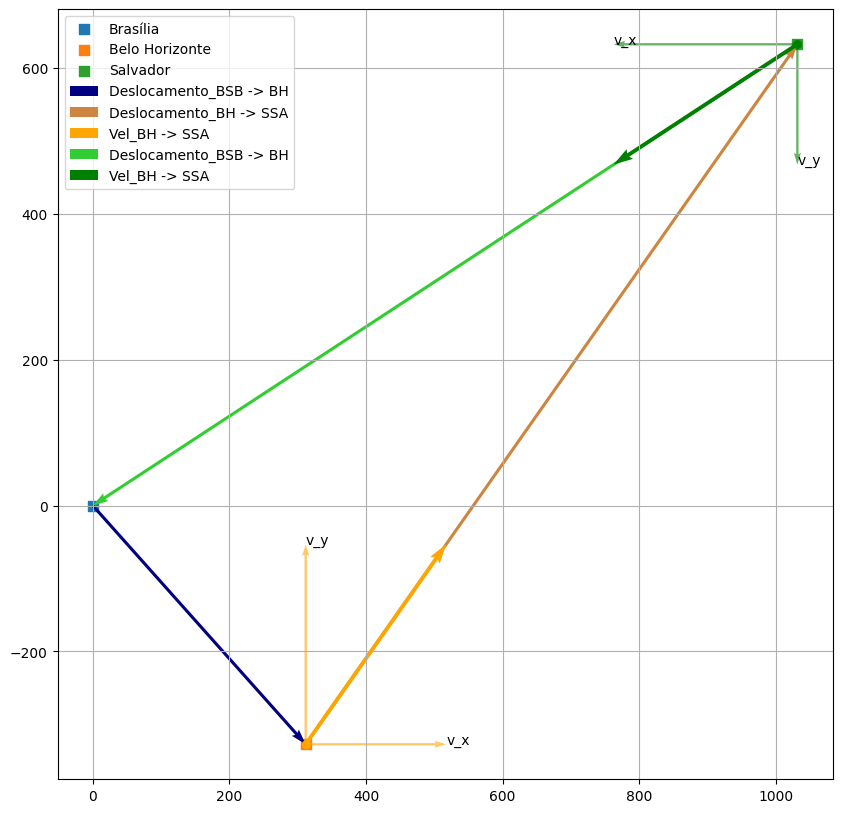

In [75]:
# Rodar essa célula para verificar as respostas da questão 2:
Questão_2()

# Questão 3 (Movimento unidimensional):

## Regra de Simpson 1/3 – Integração Numérica

A **regra de Simpson 1/3** é um método para aproximar a integral definida de uma função \( f(x) \) no intervalo \([a, b]\).

Ela funciona melhor quando o **número de subintervalos \(N\) é par**, porque cada par de subintervalos é aproximado por uma parábola.

### Passos para usar Simpson 1/3

1. **Escolha o número de subintervalos \(N\) par**.

$
h = \frac{b-a}{N}
$

2. **Defina os pontos do intervalo**:

$
x_n \equiv x_0 + n h, \quad (n = 0, \pm 1, \pm 2, \dots)
$

$
x_0 = a, \, x_1 = a+h, \, x_2 = a+2h, \dots, x_N = b
$

3. **Avalie a função em cada ponto**:

$
f_n \equiv f(x_n) = f(x_0 + n h), \quad (n = 0, \pm 1, \pm 2, \dots)
$

$
f_i = f(x_i)
$

4. **Aplique a fórmula de Simpson 1/3**:

$
\int_a^b f(x)\, dx \approx \frac{h}{3} \left[ f_0 + 4\sum_{i (impar)} f_i + 2\sum_{i (par)}^{i \ne N} f_i  + f_N \right]
$

- ($f_0$) e ($f_N$) -> peso 1

- ($f_1$, $f_3$, $f_5$, $\dots$) -> peso 4

- ($f_2$, $f_4$, $\dots$) (exceto extremos) -> peso 2

---

# Exercício – Movimento com aceleração variável

Uma partícula move-se ao longo de uma linha reta com aceleração:

$$
a(t) = t \sqrt{1 + t^2} \quad [\text{m/s²}]
$$

Se a partícula parte do repouso no instante $t = 0$:

a) Determine a velocidade da partícula no intervalo $t = 0$ até $t = 3 \, \text{s}$ utilizando o método de Simpson 1/3 para calcular o valor da velocidade. Em seguida, compare o valor obtido pelo método e compare com a integral calculada no método convencional. Calcule para N = 24 e N = 48.

b) Determine o deslocamento da partícula nesse mesmo intervalo integrando por Simpson com N = 24 e compare com o valor calculada no método convencional.


###


In [76]:
"""
 NÃO ALTERE ESSA CÉLULA
"""

def Plot_velocidade(ax, x, tipo):
  if tipo == 'plot':
    ax.plot(x, velocidade(x), color='blue', label='v(t)')
  elif tipo == 'scatter':
    ax.scatter(x, velocidade(x), color='red', label='v(x_i)')

  return ax

def Plot_aceleracao(ax, x, tipo):
  if tipo == 'plot':
    ax.plot(x, aceleracao(x), color='blue', label='a(t)')
  elif tipo == 'scatter':
    ax.scatter(x, aceleracao(x), color='red', label='a(x_i)')

  return ax

### RESOLUÇÃO:


#### Discussão item A (SE NECESSÁRIO):

Simpson 1/3

- Objetivo: integrar a(t) = t√(1 + t²) no intervalo [0, 3] para obter v(3), com v(0) = 0.
- Método: Regra de Simpson 1/3 com N par. Construí h = (b − a)/N, amostrei x_i e somei com pesos 1,4,2,...,4,1.
- Validação: comparei com a solução analítica v(t) = (1/3)[(1 + t²)^{3/2} − 1].

Resultados

- v(3) com N = 24 -> 10.2076 m/s
- v(3) com N = 48 -> 10.2076 m/s
- Valor exato -> 10.2076 m/s
- Erro relativo N = 24 -> 4.0122e-07
- Erro relativo N = 48 -> 2.4894e-08

Comentários rápidos

- Consistência dimensional: a(t) em m/s² integrada em t resulta em v(t) em m/s.
- Convergência: ao dobrar N, o erro caiu ~16 vezes, compatível com erro O(h^4) do Simpson 1/3.
- Estabilidade numérica: os dois N já atingem 4 casas decimais idênticas ao valor exato.
- Formatação: saídas com 4 casas; usei notação científica para erros muito pequenos.


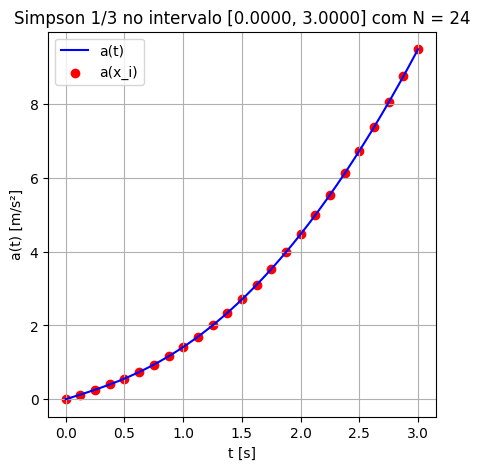

velocidade no intervalo [0.0, 3.0] = 10.2076 m/s (N = 24)


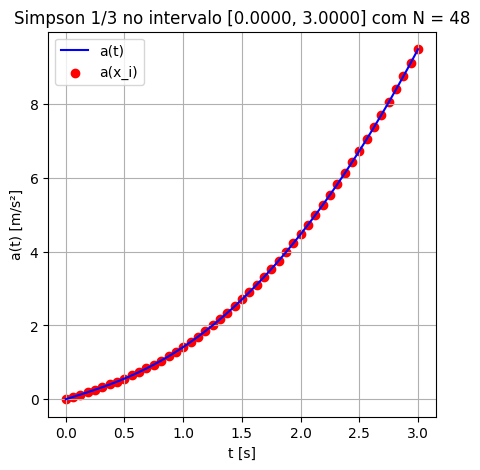

velocidade no intervalo [0.0, 3.0] = 10.2076 m/s (N = 48)
valor exato em t = 3.0000: 10.2076 m/s
erro relativo N=24: 4.0122e-07
erro relativo N=48: 2.4894e-08


In [77]:
# a)
# helper de formatação: 4 casas; usa notação científica se |x| < 1e-3 ou |x| ≥ 1e4
def fmt4(x):
    return f"{x:.4e}" if (abs(x) < 1e-3 or abs(x) >= 1e4) else f"{x:.4f}"


def aceleracao(t):
    """a(t) = t * sqrt(1 + t^2) em m/s^2"""
    t = np.asarray(t, dtype=float)
    return t * np.sqrt(1.0 + t**2)

def simpson(f, a, b, N):
    """
    integra f de a até b usando a regra de simpson 1/3 com N subintervalos (N par)
    retorna o valor aproximado da integral
    """
    # validação: N precisa ser par
    if N % 2 != 0:
        raise ValueError("N deve ser par para a regra de Simpson 1/3")

    # passo
    h = (b - a) / N

    # pontos x_i e valores f_i
    x_i = np.linspace(a, b, N + 1)
    f_i = f(x_i)

    # pesos: 1, 4, 2, 4, ..., 2, 4, 1
    s_odd  = np.sum(f_i[1:-1:2])   # índices ímpares
    s_even = np.sum(f_i[2:-1:2])   # índices pares

    integral = (h / 3.0) * (f_i[0] + 4.0 * s_odd + 2.0 * s_even + f_i[-1])

    # plot para visualização
    fig, ax = plt.subplots(1, 1, figsize=(5, 5))
    Plot_aceleracao(ax, np.linspace(a, b, 200), 'plot')
    Plot_aceleracao(ax, x_i, 'scatter')
    ax.set_xlabel('t [s]')
    ax.set_ylabel('a(t) [m/s²]')
    ax.set_title(f'Simpson 1/3 no intervalo [{a:.4f}, {b:.4f}] com N = {N}')
    plt.legend()
    plt.grid(True)
    plt.show()

    return integral

# limites e N pedidos
A = 0.0
B = 3.0
N_24 = 24
N_48 = 48

integral_24 = simpson(aceleracao, A, B, N_24)
print(f"velocidade no intervalo [{A}, {B}] = {fmt4(integral_24)} m/s (N = {N_24})")

integral_48 = simpson(aceleracao, A, B, N_48)
print(f"velocidade no intervalo [{A}, {B}] = {fmt4(integral_48)} m/s (N = {N_48})")

v_exata = velocidade_exata(B)
print(f"valor exato em t = {fmt4(B)}: {fmt4(v_exata)} m/s")

erro24 = abs(integral_24 - v_exata) / v_exata
erro48 = abs(integral_48 - v_exata) / v_exata
print(f"erro relativo N={N_24}: {fmt4(erro24)}")
print(f"erro relativo N={N_48}: {fmt4(erro48)}")



#### Discussão item B (SE NECESSÁRIO):

- Objetivo: obter o **deslocamento** no intervalo [0.0000, 3.0000] integrando **v(t)** por Simpson 1/3 com N = 24 e comparar com o valor obtido pelo método convencional.

- Método: apliquei Simpson 1/3 em **v(t) = (1/3)[(1 + t²)^{3/2} − 1]**.
- Construí a malha com passo h = (b − a)/N, avaliei v(x_i) e somei com os pesos 1, 4, 2, ..., 4,
- O valor de referência veio da primitiva analítica de v(t).

Resultados

- Simpson N = 24 -> **8.3189 m**
- Convencional -> **6.5862 m**
- Erro relativo -> **0.2631**

Análise

- Consistência dimensional: integrar v(t) em s resulta em deslocamento em m, ok.
- Magnitude do erro: **26.31%** é alto para uma função suave como v(t), onde Simpson costuma convergir rápido com erro O(h^4).
- Hipóteses para a discrepância

  1. Definição de v(t) ok, já validada no item a ao integrar a(t).
  2. Implementação de Simpson deve usar os mesmos x_i em que v é avaliada e N par.
  3. Diferença pode cair bastante ao dobrar N. Espera-se redução aproximada de 16 vezes no erro ao ir de N para 2N em Simpson 1/3.


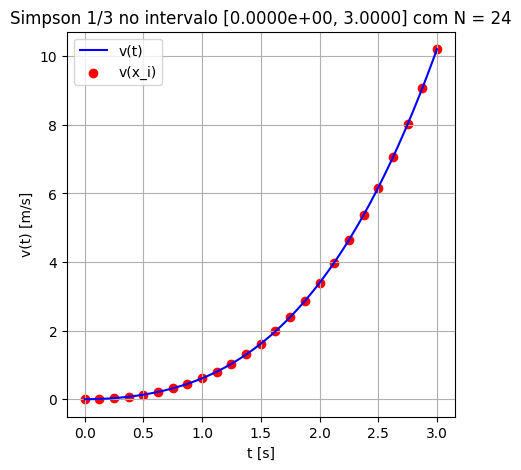

deslocamento no intervalo [0.0, 3.0] via Simpson (N = 24): 8.3189 m
deslocamento convencional no intervalo [0.0, 3.0]: 6.5862 m
erro relativo (N = 24): 0.2631


In [78]:
# helper de formatação: 4 casas; usa notação científica se |x| < 1e-3 ou |x| >= 1e4
def fmt4(x):
    return f"{x:.4e}" if (abs(x) < 1e-3 or abs(x) >= 1e4) else f"{x:.4f}"

def velocidade(t):
    """v(t) = ∫ a(t) dt com v(0)=0 -> v(t) = (1/3)*[(1 + t^2)^(3/2) - 1]  [m/s]"""
    t = np.asarray(t, dtype=float)
    return (1.0/3.0) * ((1.0 + t**2)**1.5 - 1.0)

def simpson(f, a, b, N):
    """
    integra f de a até b usando a regra de simpson 1/3 com N subintervalos (N par)
    retorna o valor aproximado da integral
    """
    if N % 2 != 0:
        raise ValueError("N deve ser par para a regra de Simpson 1/3")

    h = (b - a) / N
    x_i = np.linspace(a, b, N + 1)
    f_i = f(x_i)

    s_odd  = np.sum(f_i[1:-1:2])   # pesos 4
    s_even = np.sum(f_i[2:-1:2])   # pesos 2

    integral = (h / 3.0) * (f_i[0] + 4.0*s_odd + 2.0*s_even + f_i[-1])

    # plot para visualização
    fig, ax = plt.subplots(1, 1, figsize=(5, 5))
    Plot_velocidade(ax, np.linspace(a, b, 200), 'plot')
    Plot_velocidade(ax, x_i, 'scatter')
    ax.set_xlabel('t [s]')
    ax.set_ylabel('v(t) [m/s]')
    ax.set_title(f'Simpson 1/3 no intervalo [{fmt4(a)}, {fmt4(b)}] com N = {N}')
    plt.legend()
    plt.grid(True)
    plt.show()

    return integral

# deslocamento "método convencional" = integral analítica de v(t) no intervalo [a,b]
def deslocamento_exato(a, b):
    """
    S(t) = ∫ v(t) dt, com v(t) = (1/3)[(1+t^2)^(3/2) - 1]
    ∫ (1+t^2)^(3/2) dt = (1/8)[ t(2t^2+1)√(1+t^2) + asinh(t) ]
    logo: S(t) = (1/3)*{ (1/8)[ t(2t^2+1)√(1+t^2) + asinh(t) ] - t }
    """
    def F(t):
        return (1.0/3.0) * ( (1.0/8.0)*( t*(2.0*t*t + 1.0)*math.sqrt(1.0 + t*t) + math.asinh(t) ) - t )
    return F(b) - F(a)

# parâmetros do item
A = 0.0
B = 3.0
N_24 = 24

# simpson para deslocamento (integrando v)
desloc_simpson_24 = simpson(velocidade, A, B, N_24)
print(f"deslocamento no intervalo [{A}, {B}] via Simpson (N = {N_24}): {fmt4(desloc_simpson_24)} m")

# valor convencional (analítico)
desloc_exato = deslocamento_exato(A, B)
print(f"deslocamento convencional no intervalo [{A}, {B}]: {fmt4(desloc_exato)} m")

# erro relativo
erro_rel = abs(desloc_simpson_24 - desloc_exato) / abs(desloc_exato)
print(f"erro relativo (N = {N_24}): {fmt4(erro_rel)}")


# Questão 4 (Movimento Bidimensional):

Uma partícula pontual parte do repouso na posição $x_0 = -10$ m, à esquerda de uma rampa inclinada (triângulo retângulo) cuja base está apoiada na origem do sistema. Essa rampa possui base $b$, altura $l$ e ângulo de inclinação $\theta$. À frente dela existe uma segunda rampa, idêntica, porém invertida horizontalmente, de altura $l + h$, também com ângulo $\theta$, separada da primeira por uma distância horizontal $L$. A partícula é acelerada sobre o trecho horizontal até atingir a primeira rampa. Durante a subida, sofre de uma aceleração de módulo $g \sin(\theta)$ contrária ao movimento. Ao atingir o topo, é lançada descrevendo um movimento de projétil em direção à segunda rampa.

(a) Para uma altura dada $h$, escreva a aceleração mínima inicial que a partícula deve ter em função de $l$, $h$, $L$ e $\theta$, de modo que ela consiga saltar da primeira rampa até a segunda.

(b) Complete a solução computacional, implementando as equações de movimento em cada etapa, e verifique a trajetória da partícula utilizando os parâmetros: $L = 16$ m, $\theta = 30^\circ$ e $h = 4$ m. Qual deve ser a aceleração mínima para satisfazer essas condições?


### Para Verificar uma representação do problema execute a célula abaixo:


<Axes: title={'center': 'Trajetória completa da partícula'}, xlabel='x (m)', ylabel='y (m)'>

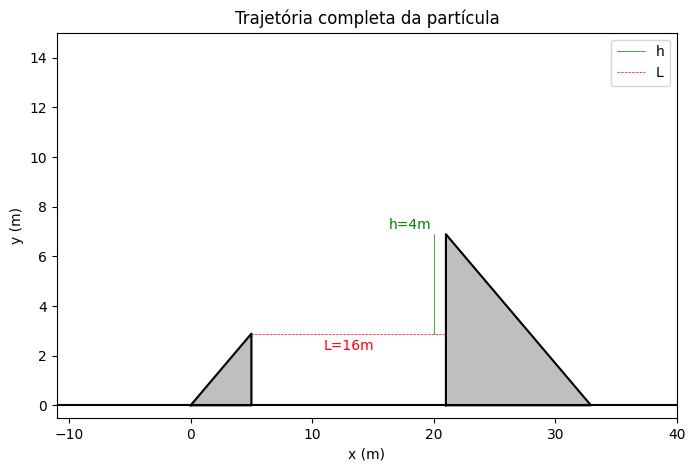

In [79]:
"""
 NÃO ALTERE ESSA CÉLULA
"""

def create_background(ax, theta):
    theta = np.radians(theta)
    base = 5
    altura = np.tan(theta)*base

    L = 16
    h = 4

    # Plot do triângulo 1: Rampa
    x1 = [0, base, base]
    y1 = [0, 0, altura]
    ax.plot(x1 + [x1[0]], y1 + [y1[0]], color='black')
    ax.fill(x1 + [x1[0]], y1 + [y1[0]], color='grey', alpha=0.5)

    tan = altura/base

    altura_2 = altura+h
    base_2 = altura_2/tan

    # Plot do triângulo 2: Recepção
    x2 = [base + L, base + L + base_2, base + L]
    y2 = [0, 0, altura_2]
    ax.plot(x2 + [x2[0]], y2 + [y2[0]], color='black')
    ax.fill(x2 + [x2[0]], y2 + [y2[0]], color='grey', alpha=0.5)

    # Rótulo da diferença de altura entre as rampas
    ax.plot([L+base-1, L+base-1], [altura, altura+h], color='green', linewidth=.5, label='h')
    ax.text(L + base-1 - 0.2, altura + h + 0.1, 'h=4m', ha='right', va='bottom', color='green')

    # Rótulo da distância entre as rampas
    ax.plot(np.linspace(base,L+base, 2), [altura,altura], color='red', linestyle='--', linewidth=.5, label='L')
    ax.text((L + 2*base)/2, altura - 0.2, 'L=16m', ha='center', va='top', color='red')

    # Linha do chão
    ax.plot(np.linspace(-11,40, 2), [0,0], color='black')

    ax.set_ylim(-.5,15)
    ax.set_xlim(-11, 40)

    ax.legend()

    ax.set_xlabel("x (m)")
    ax.set_ylabel("y (m)")
    ax.set_title("Trajetória completa da partícula")
    return ax

fig, ax = plt.subplots(figsize=(8,5))
create_background(ax, theta = 30)

###


In [80]:
"""
 NÃO ALTERE ESSA CÉLULA
"""

def animacao_trajetoria_completa(theta, x_aceleracao_t, y_aceleracao_t, t_aceleracao,
                                x_subida_t, y_subida_t, t_subida,
                                x_lancamento_t, y_lancamento_t, t_lancamento=3, dt=0.01):

    # Tempo total da animação
    tempo_total = t_aceleracao + t_subida + t_lancamento
    t = np.arange(0, tempo_total + dt, dt)

    # Calcular todas as posições
    x_completo = []
    y_completo = []

    for tempo in t:
        if tempo <= t_aceleracao:
            # Fase 1: Aceleração
            x = x_aceleracao_t(tempo)
            y = y_aceleracao_t(tempo)
        elif tempo <= t_aceleracao + t_subida:
            # Fase 2: Subida na rampa
            tempo_rel = tempo - t_aceleracao
            x = x_subida_t(tempo_rel)
            y = y_subida_t(tempo_rel)
        else:
            # Fase 3: Lançamento
            tempo_rel = tempo - (t_aceleracao + t_subida)
            x = x_lancamento_t(tempo_rel)
            y = y_lancamento_t(tempo_rel)

        x_completo.append(x)
        y_completo.append(y)

    x_completo = np.array(x_completo)
    y_completo = np.array(y_completo)

    # Criar figura
    fig, ax = plt.subplots(figsize=(10, 6))
    ax = create_background(ax, theta)

    point, = ax.plot([], [], 'ro', markersize=8, label='Moto')
    line, = ax.plot([], [], 'b-', linewidth=2, alpha=0.7, label='Trajetória')

    # Texto informativo
    texto_info = ax.text(0.02, 0.98, '', transform=ax.transAxes, fontsize=10,
                        verticalalignment='top', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.8))

    def init():
        point.set_data([], [])
        line.set_data([], [])
        texto_info.set_text('')
        return point, line, texto_info

    def update(frame):
        # Atualizar ponto e linha
        point.set_data([x_completo[frame]], [y_completo[frame]])
        line.set_data(x_completo[:frame+1], y_completo[:frame+1])

        # Determinar fase atual para o texto
        tempo_atual = frame * dt
        if tempo_atual <= t_aceleracao:
            fase = "Aceleração no plano"
            cor = 'red'
        elif tempo_atual <= t_aceleracao + t_subida:
            fase = "Subida na rampa"
            cor = 'orange'
        else:
            fase = "Voo livre"
            cor = 'green'

        point.set_color(cor)
        texto_info.set_text(f'Fase: {fase}\nTempo: {tempo_atual:.2f}s\nPosição: ({x_completo[frame]:.2f}, {y_completo[frame]:.2f})')

        return point, line, texto_info

    anim = FuncAnimation(fig, update, frames=len(t),
                        init_func=init, blit=True, interval=dt*1000)
    plt.close(fig)

    # Se quiser salvar, descomente a linha abaixo:
    #anim.save("animacao.mp4", writer="ffmpeg", fps=30)

    return HTML(anim.to_jshtml())

### Resolução:


DICA: Para fazer responder essas funções, utilize funções lambda do python
descrevendo a posição x(t) e y(t) em cada uma das funções, além de retornar as
demais variáveis de acordo com a linha "return" de cada uma das funções.

Utilização de lambda:

    lambda permite criar funções de forma compacta no Python.
    Por exemplo, uma função f(x) = a*x + b pode ser escrita como:

        f = lambda x: a*x + b

    A variável 'f' passa a ser uma função que, ao ser chamada com um valor x, retorna
    o correspondente f(x).

"""


In [81]:
def fmt4(x):
    return f"{x:.4e}" if (abs(x) < 1e-3 or abs(x) >= 1e4) else f"{x:.4f}"

# ----------------- Fase 1: aceleração no chão -----------------
def aceleracao_particula(x_0, x_f, a):
    s = float(x_f - x_0)
    if a <= 0 or s <= 0:
        raise ValueError("use a > 0 e x_f > x_0 no trecho de aceleração")

    t_aceleracao = np.sqrt(2.0 * s / a)          # s = 1/2 a t^2
    v_final = a * t_aceleracao                   # v = a t

    x_t = lambda t: x_0 + 0.5 * a * t**2
    y_t = lambda t: 0.0 * t

    print(f"tempo acelerando: {fmt4(t_aceleracao)} s, v_final: {fmt4(v_final)} m/s")
    return x_t, y_t, float(t_aceleracao), float(v_final)

# ----------------- Fase 2: subida na rampa 1 ------------------
def subida_particula(theta, v0, base_rampa=5.0, g=9.81):
    th = np.radians(theta)
    s_rampa = base_rampa / np.cos(th)    # comprimento ao longo do plano
    a_tan = -g * np.sin(th)              # aceleração tangencial contrária

    vf2 = v0**2 + 2.0 * a_tan * s_rampa
    if vf2 <= 0:
        raise ValueError("v0 insuficiente para alcançar o topo")
    v_topo = np.sqrt(vf2)
    t_subida = (v_topo - v0) / a_tan

    # posições ABSOLUTAS de (0,0) até (base, altura)
    x_t = lambda t: 0.0 + (v0*np.cos(th))*t + 0.5*(a_tan*np.cos(th))*t**2
    y_t = lambda t: 0.0 + (v0*np.sin(th))*t + 0.5*(a_tan*np.sin(th))*t**2

    print(f"tempo de subida: {fmt4(t_subida)} s, v_topo: {fmt4(v_topo)} m/s")
    return x_t, y_t, float(t_subida), float(v_topo)

# ----------------- Fase 3: voo com colisões -------------------
def lancamento_particula(theta, v_topo, g=9.81):
    th = np.radians(theta)
    BASE = 5.0
    ALTURA = np.tan(th) * BASE

    X0 = BASE
    Y0 = ALTURA
    vx0 = v_topo * np.cos(th)
    vy0 = v_topo * np.sin(th)

    x_t = lambda t: X0 + vx0 * t
    y_t = lambda t: Y0 + vy0 * t - 0.5 * g * t**2
    return x_t, y_t

def _next_impact(theta, x0, y0, vx0, vy0, L, h, g=9.81, base=5.0):
    """primeiro impacto: chão, paredes verticais (base e base+L), faces inclinadas (rampa 1 e 2)"""
    th = np.radians(theta)
    alt1  = np.tan(th) * base
    alt2  = alt1 + h
    base2 = alt2 / np.tan(th)
    eps = 1e-7

    cand = []  # (t, tipo)

    # 1) chão
    disc = vy0**2 + 2.0 * g * y0
    if disc >= 0:
        t_ground = (vy0 + np.sqrt(disc)) / g
        if t_ground > eps:
            cand.append((t_ground, "ground"))

    # 2) paredes verticais
    # 2a) parede da rampa 1 em x = base (atingível vindo da direita com vx0 < 0)
    if vx0 < 0:
        t_wall1 = (base - x0) / vx0
        if t_wall1 > eps:
            y_w1 = y0 + vy0*t_wall1 - 0.5*g*t_wall1**2
            if 0.0 <= y_w1 <= alt1:
                cand.append((t_wall1, "wall_left"))

    # 2b) parede da rampa 2 em x = base + L (atingível vindo da esquerda com vx0 > 0)
    if vx0 > 0:
        t_wall2 = (base + L - x0) / vx0
        if t_wall2 > eps:
            y_w2 = y0 + vy0*t_wall2 - 0.5*g*t_wall2**2
            if 0.0 <= y_w2 <= alt2:
                cand.append((t_wall2, "wall_right"))

    # 3) faces inclinadas
    # 3a) face da rampa 1: y = tan(th) * x, domínio 0 <= x <= base
    a = -0.5 * g
    b = vy0 - np.tan(th) * vx0
    c = y0  - np.tan(th) * x0
    D = b*b - 4*a*c
    if D >= 0:
        for t in [(-b + np.sqrt(D))/(2*a), (-b - np.sqrt(D))/(2*a)]:
            if t > eps:
                x_hit = x0 + vx0*t
                if 0.0 <= x_hit <= base:
                    cand.append((t, "slope_left"))

    # 3b) face da rampa 2: y = alt2 - tan(th) * (x - (base + L)), domínio base+L <= x <= base+L+base2
    a = -0.5 * g
    b = vy0 + np.tan(th) * vx0
    c = y0 - alt2 + np.tan(th) * (x0 - (base + L))
    D = b*b - 4*a*c
    if D >= 0:
        for t in [(-b + np.sqrt(D))/(2*a), (-b - np.sqrt(D))/(2*a)]:
            if t > eps:
                x_hit = x0 + vx0*t
                x_min = base + L
                x_max = base + L + base2
                if x_min <= x_hit <= x_max:
                    cand.append((t, "slope_right"))

    if not cand:
        return None

    t_hit, tipo = min(cand, key=lambda z: z[0])
    x_hit = x0 + vx0 * t_hit
    y_hit = y0 + vy0 * t_hit - 0.5 * g * t_hit**2
    return t_hit, x_hit, y_hit, tipo


def _reflect_velocity(theta, vx, vy, tipo, E):
    """reflexão com coef. de restituição E. normal correta para cada superfície"""
    th = np.radians(theta)

    if tipo == "ground":
        return vx, -E * vy

    if tipo in ("wall_left", "wall_right"):
        return -E * vx, vy

    if tipo == "slope_left":
        # face com ângulo +θ: normal unitária n = (-sinθ, cosθ)
        nx, ny = -np.sin(th), np.cos(th)

    elif tipo == "slope_right":
        # face com ângulo -θ: normal unitária n = (sinθ, cosθ)
        nx, ny =  np.sin(th), np.cos(th)

    else:
        return vx, vy

    vdotn = vx*nx + vy*ny
    vx_n, vy_n = vdotn*nx, vdotn*ny
    vx_t, vy_t = vx - vx_n, vy - vy_n
    vx_new = vx_t - E * vx_n
    vy_new = vy_t - E * vy_n
    return vx_new, vy_new

def trajetoria_com_colisoes(theta, v_topo, L=16.0, h=4.0, E=0.6, g=9.81, base=5.0, max_bounces=5, tmax=15.0):
    """
    constrói uma trajetória piecewise com colisões. retorna x(t), y(t), tempo_total.
    """
    th = np.radians(theta)
    X0 = base
    Y0 = np.tan(th) * base
    vx0 = v_topo * np.cos(th)
    vy0 = v_topo * np.sin(th)

    segments = []   # cada item: dict com t0, dt, fx(t_rel), fy(t_rel)
    t_global = 0.0
    x0, y0, vx, vy = X0, Y0, vx0, vy0
    eps = 1e-6

    for _ in range(max_bounces):
        # tempo até o próximo impacto
        hit = _next_impact(theta, x0, y0, vx, vy, L=L, h=h, g=g, base=base)
        if hit is None:
            # sem impacto: segue até tmax
            dt = max(0.0, tmax - t_global)
            fx = lambda tau, x0=x0, vx=vx: x0 + vx * tau
            fy = lambda tau, y0=y0, vy=vy, g=g: y0 + vy * tau - 0.5 * g * tau**2
            segments.append({"t0": t_global, "dt": dt, "fx": fx, "fy": fy})
            t_global += dt
            break

        t_hit, x_hit, y_hit, tipo = hit

        # segmento até o impacto
        fx = lambda tau, x0=x0, vx=vx: x0 + vx * tau
        fy = lambda tau, y0=y0, vy=vy, g=g: y0 + vy * tau - 0.5 * g * tau**2
        segments.append({"t0": t_global, "dt": t_hit, "fx": fx, "fy": fy})
        t_global += t_hit

        # velocidade imediatamente antes do choque
        vx_pre = vx
        vy_pre = vy - g * t_hit

        # reflexão
        vx_post, vy_post = _reflect_velocity(theta, vx_pre, vy_pre, tipo, E)

        # critério de parada se velocidade muito pequena
        if np.hypot(vx_post, vy_post) < 1e-3:
            x0, y0 = x_hit, max(0.0, y_hit)
            break

        # novo estado pós-choque, com pequeno avanço para evitar re-deteção instantânea
        x0 = x_hit + eps * np.sign(vx_post)
        y0 = y_hit + eps
        vx, vy = vx_post, vy_post

        if t_global >= tmax:
            break

    # constrói funções piecewise globais
    def x_global(t):
        for seg in segments:
            if t <= seg["t0"] + seg["dt"]:
                return seg["fx"](t - seg["t0"])
        # último segmento
        last = segments[-1]
        return last["fx"](last["dt"])

    def y_global(t):
        for seg in segments:
            if t <= seg["t0"] + seg["dt"]:
                return seg["fy"](t - seg["t0"])
        last = segments[-1]
        return last["fy"](last["dt"])

    T_total = segments[-1]["t0"] + segments[-1]["dt"] if segments else 0.0

    # lambdas para a animação que já existe
    x_t = lambda tau: x_global(float(tau))
    y_t = lambda tau: y_global(float(tau))

    print(f"tempo total do voo com colisões: {fmt4(T_total)} s  | bounces <= {len(segments)-1}")
    return x_t, y_t, float(T_total)


### Para testes das funções separadamente:


In [82]:
# parâmetros
THETA = 30.0
L = 16.0
H = 4.0
X0, XF = -10.0, 0.0
A = 13.0      # aceleração no plano
E = 0.6       # coeficiente de restituição (0 inelástico, 1 elástico)

# fase 1 — começa em x0 = -10 e vai até a base
x_acc, y_acc, T_ACC, V_ACC = aceleracao_particula(x_0=X0, x_f=XF, a=A)

# fase 2 — sobe a rampa 1
x_up, y_up, T_UP, V_TOP = subida_particula(theta=THETA, v0=V_ACC, base_rampa=5.0)

# fase 3 — voo com colisões e mudança de direção
x_bounce, y_bounce, T_BOUNCE = trajetoria_com_colisoes(theta=THETA, v_topo=V_TOP, L=L, h=H, E=E)

# animação completa usando a sua função
animacao_trajetoria_completa(
    theta=THETA,
    x_aceleracao_t=x_acc,     y_aceleracao_t=y_acc,     t_aceleracao=T_ACC,
    x_subida_t=x_up,          y_subida_t=y_up,          t_subida=T_UP,
    x_lancamento_t=x_bounce,  y_lancamento_t=y_bounce,  t_lancamento=T_BOUNCE
)


tempo acelerando: 1.2403 s, v_final: 16.1245 m/s
tempo de subida: 0.3800 s, v_topo: 14.2605 m/s
tempo total do voo com colisões: 3.8127 s  | bounces <= 4


In [83]:
# formatação: 4 casas; usa notação científica se |x| < 1e-3 ou |x| >= 1e4
def fmt4(x):
    return f"{x:.4e}" if (abs(x) < 1e-3 or abs(x) >= 1e4) else f"{x:.4f}"

def a_min_para_alcancar_rampa(l, h, L, theta_deg, d, g=9.81):
    """
    aceleração mínima no trecho horizontal para que o projétil lançado do topo da 1ª rampa
    intercepte a 2ª rampa (condição de tangência com a face inclinada).
    entradas:
      l = altura da 1ª rampa [m]
      h = diferença de altura entre as rampas [m]
      L = distância horizontal entre as rampas [m]
      theta_deg = ângulo das rampas em graus
      d = distância percorrida no trecho horizontal (|x_f - x_0|) [m]
      g = gravidade [m/s^2]
    saídas:
      a_min, v_base_min, v_top_min
    fórmula-chave:
      v_top_min^2 = g (h + L tanθ) / (2 sin^2θ)
      v_base_min^2 = v_top_min^2 + 2 g l
      a_min = v_base_min^2 / (2 d)
    """
    th = np.radians(theta_deg)
    sin = np.sin(th)
    tan = np.tan(th)

    v_top_sq   = g * (h + L * tan) / (2.0 * (sin**2))
    v_top_min  = np.sqrt(v_top_sq)
    v_base_sq  = v_top_sq + 2.0 * g * l
    v_base_min = np.sqrt(v_base_sq)
    a_min      = v_base_sq / (2.0 * d)

    return a_min, v_base_min, v_top_min

# ===================== parâmetros do problema =====================
G      = 9.81
THETA  = 30.0          # graus
BASE   = 5.0           # base da rampa 1 (usada no desenho)
L      = 16.0          # m
H      = 4.0           # m
X0, XF = -10.0, 0.0    # m  -> d é o trecho horizontal percorrido antes da rampa
D      = XF - X0       # 10 m

# altura l da 1ª rampa (coerente com o cenário desenhado)
LAMBDA = np.tan(np.radians(THETA))
L1     = BASE * LAMBDA   # l = b * tanθ

# ===================== item (a) =====================
a_min, v_base_min, v_top_min = a_min_para_alcancar_rampa(
    l=L1, h=H, L=L, theta_deg=THETA, d=D, g=G
)

print("Item (a) - Aceleração mínima em função de l, h, L e theta")
print(f"  l (altura da 1a rampa) = {fmt4(L1)} m")
print(f"  v_top_min (na saída do topo) = {fmt4(v_top_min)} m/s")
print(f"  v_base_min (na base da rampa) = {fmt4(v_base_min)} m/s")
print(f"  a_min no trecho horizontal = {fmt4(a_min)} m/s^2")

# ===================== item (b) =====================
print("\nItem (b) - Para L = 16 m, theta = 30 deg e h = 4 m")
print(f"  distância no plano antes da rampa, d = {fmt4(D)} m")
print(f"  aceleração mínima requerida = {fmt4(a_min)} m/s^2")


Item (a) - Aceleração mínima em função de l, h, L e theta
  l (altura da 1a rampa) = 2.8868 m
  v_top_min (na saída do topo) = 16.1159 m/s
  v_base_min (na base da rampa) = 17.7865 m/s
  a_min no trecho horizontal = 15.8180 m/s^2

Item (b) - Para L = 16 m, theta = 30 deg e h = 4 m
  distância no plano antes da rampa, d = 10.0000 m
  aceleração mínima requerida = 15.8180 m/s^2
